## Cell Overlaps Affect de Novo Cell Type Discovery
This notebook investigates the impact of vertical signal integrity (VSI) on the identification of novel cell types in spatial transcriptomics data.  

**Background**  
Using spatial transcriptomics of the mouse hypothalamus (Moffitt et al., 2018), the `BANKSY` algorithm (Singhal et al., 2024) identified two subtypes within mature oligodendrocytes (MODs). These subtypes were defined based on spatial clustering and subtype-specific markers, with validation using matched single-cell RNA-seq data.  

**Methods and Key Findings**  
To evaluate the reliability of these subtypes, `ovrl.py` was used to assess VSI across the tissue section.  
VSI were examined under four conditions:  
- All transcripts: MOD2 cells exhibit lower VSI, indicating increased signal mixing.
- Excluding MOD1 markers: VSI remains unchanged.
- Excluding MOD2 markers: VSI improves.
- Excluding all MOD markers: Similar improvement as excluding MOD2 markers alone.

Marker analysis revealed:  
- MOD1/2 markers are broadly expressed beyond MOD cells.  
- Inconsistencies between marker expression in ST and scRNA-seq.  
- Many MOD2 markers are highly expressed in neurons, suggesting potential signal mixing.  

**Conclusion**  
While the existence of MOD1 and MOD2 cannot be definitively ruled out, the current evidence points to limitations in the subtypes identified by `BANSKY`.  

In [1]:
from pathlib import Path

import sys
import os
sys.path.append(os.path.abspath("../src"))

from utils import load_merfish_signal_df, load_banksy_result, load_merfish_data, load_boundaries_data, load_scRNA_data
from utils import extract_cell_vsi
from plot import plot_VSI_map, plot_vsi_distribution_comparison, plot_normalized_histogram, plot_vsi_qqplot
from plot import histogram_comparison, plot_marker_signals, plot_annotate_heatmap

import numpy as np
import pandas as pd
from IPython.display import display

### data

#### Results of Ovrlpy
`ovrl.py` was executed in separate notebooks:  
- Ovrlpy_all_transcripts.ipynb  
- Ovrlpy_no_MOD_markers.ipynb  
- Ovrlpy_no_MOD1_markers.ipynb  
- Ovrlpy_no_MOD2_markers.ipynb

In this notebook, we use the output:  
- Signal integrity  
- Signal strength  

generated from above notebooks.  

In [2]:
ovrlpy_result_folder = Path("../data/results/VSI/")
signal_integrity = np.loadtxt(ovrlpy_result_folder/"SignalIntegrity.txt")
signal_strength = np.loadtxt(ovrlpy_result_folder/"SignalStrength.txt")

In [3]:
# exclude MOD marker signals
nonMOD_signal_integrity = np.loadtxt(ovrlpy_result_folder/"SignalIntegrity_exMOD.txt")
nonMOD_signal_strength = np.loadtxt(ovrlpy_result_folder/"SignalStrength_exMOD.txt")

In [4]:
# exclude MOD marker signals
nonMOD1_signal_integrity = np.loadtxt(ovrlpy_result_folder/"SignalIntegrity_exMOD1.txt")
nonMOD1_signal_strength = np.loadtxt(ovrlpy_result_folder/"SignalStrength_exMOD1.txt")

In [5]:
# exclude MOD marker signals
nonMOD2_signal_integrity = np.loadtxt(ovrlpy_result_folder/"SignalIntegrity_exMOD2.txt")
nonMOD2_signal_strength = np.loadtxt(ovrlpy_result_folder/"SignalStrength_exMOD2.txt")

In [6]:
# doublets
doublets_all = pd.read_csv(ovrlpy_result_folder/"doublets_df.csv")
doublets_exMOD = pd.read_csv(ovrlpy_result_folder/"doublets_exMOD_df.csv")
doublets_exMOD1 = pd.read_csv(ovrlpy_result_folder/"doublets_exMOD1_df.csv")
doublets_exMOD2 = pd.read_csv(ovrlpy_result_folder/"doublets_exMOD2_df.csv")

#### Signals in the Tissue Section

In [7]:
MERFISH_data_folder_path = Path("../data/mouse_hypothalamus/MERFISH/")

In [8]:
signal_coordinate_df, coordinate_x_m, coordinate_y_m = load_merfish_signal_df(MERFISH_data_folder_path/"merfish_barcodes_example.csv")

#### Results of BANKSY

In [9]:
banksy_folder_path = Path("../data/banksy_results/")

In [10]:
banksy_result = load_banksy_result(banksy_folder_path/"banksy_cluster.txt", coordinate_x_m, coordinate_y_m)

In [11]:
MOD1_df = banksy_result[banksy_result['banksy_cluster'] == 8]
MOD2_df = banksy_result[banksy_result['banksy_cluster'] == 7]

differentially expressed genes identified by BANKSY

In [12]:
# all differentially expressed genes
DE_genes = ['Mlc1', 'Dgkk', 'Cbln2', 'Syt4', 'Gad1', 'Plin3', 'Gnrh1', 'Sln', 'Gjc3', 'Mbp', 'Lpar1', 'Trh', 'Ucn3', 'Cck']
# DE_genes_MOD2: 7
DE_genes_MOD2 = ['Mlc1', 'Dgkk', 'Cbln2', 'Syt4', 'Gad1', 'Plin3', 'Gnrh1', 'Sln', 'Gjc3']
# DE_genes_MOD1: 8
DE_genes_MOD1 = ['Mbp', 'Lpar1', 'Trh', 'Ucn3', 'Cck']

In [13]:
DE_gene_signals = signal_coordinate_df[signal_coordinate_df['gene'].isin(DE_genes)].copy()
MOD1_signals = signal_coordinate_df[signal_coordinate_df['gene'].isin(DE_genes_MOD1)].copy()
MOD2_signals = signal_coordinate_df[signal_coordinate_df['gene'].isin(DE_genes_MOD2)].copy()

In [14]:
Gene_Group = pd.DataFrame([0,0,0,0,0,0,0,0,0,1,1,1,1,1], columns=['cluster'])

#### Segmentation Dataset

In [15]:
merfish_data = load_merfish_data(MERFISH_data_folder_path / "merfish_all_cells.csv", 
                                 banksy_result, coordinate_x_m, coordinate_y_m, 
                                 animal_id=1, bregma_value=-0.24)

In [16]:
MOD_merfish = merfish_data[(merfish_data['banksy']==7) | (merfish_data['banksy']==8)]
MOD_merfish = MOD_merfish.sort_values(by='banksy')

common_genes = [gene for gene in DE_genes if gene in MOD_merfish.columns]
MOD_merfish_DE = MOD_merfish[common_genes].T

MOD_banksy = MOD_merfish['banksy']

#### Cell boundaries

In [17]:
boundaries_df = load_boundaries_data(MERFISH_data_folder_path/'cellboundaries_example_animal.csv', 
                                     merfish_data, coordinate_x_m, coordinate_y_m)

In [18]:
MOD_boundaries = boundaries_df[(boundaries_df['banksy'] == 8) | (boundaries_df['banksy'] == 7)]
MOD1_boundaries = boundaries_df[boundaries_df['banksy'] == 8]
MOD2_boundaries = boundaries_df[boundaries_df['banksy'] == 7]
other_boundaries = boundaries_df[~boundaries_df['banksy'].isin([8, 7])]

#### Matched Single-Cell RNA Sequencing

In [19]:
data_path = Path("../data/mouse_hypothalamus/SingleCell/")
mtx_path = data_path / "GSE113576_matrix.mtx"
barcodes_path = data_path / "GSE113576_barcodes.tsv"
genes_path = data_path / "GSE113576_genes.tsv"
meta_path = data_path / "aau5324_Moffitt_Table-S1.xlsx"

In [20]:
cell_class_dict = {
    'Astrocytes': 'Astrocytes',
    'Endothelial': 'Endothelial',
    'Ependymal': 'Ependymal',
    'Excitatory': 'Excitatory',
    'Fibroblast': 'Fibroblast',
    'Immature oligodendrocyte': 'OD immature',
    'Inhibitory': 'Inhibitory',
    'Macrophage': 'Macrophage',
    'Mature oligodendrocyte': 'OD mature',
    'Microglia': 'Microglia',
    'Mural': 'Mural',
    'Newly formed oligodendrocyte': 'OD newly formed',
}

adata = load_scRNA_data(
    mtx_path, 
    barcodes_path, 
    genes_path, 
    meta_path, 
    cell_class_filter = cell_class_dict
)

In [21]:
sc_data = adata.to_df()
sc_DE_MOD1_df = sc_data[DE_genes_MOD2]
sc_DE_MOD2_df = sc_data[DE_genes_MOD1]
sc_DE = pd.concat([sc_DE_MOD1_df, sc_DE_MOD2_df], axis=1)

sc_cell_class = adata.obs['Cell_class']

### Ovrl.py Suggests MOD2 May Be a False Subtype
`BANKSY` separated mature oligodendrocytes (MODs) into two previously undescribed, spatially distinct sub-clusters (MOD1 and MOD2) using spatial transcriptomic data.  
`Ovrl.py` analysis shows that MOD2 has lower VSI than MOD1, indicating that MOD2 cells are more affected by cell overlaps, raising the possibility that MOD2 may be a false subcluster.

#### The VSI Map across the Tissue Section

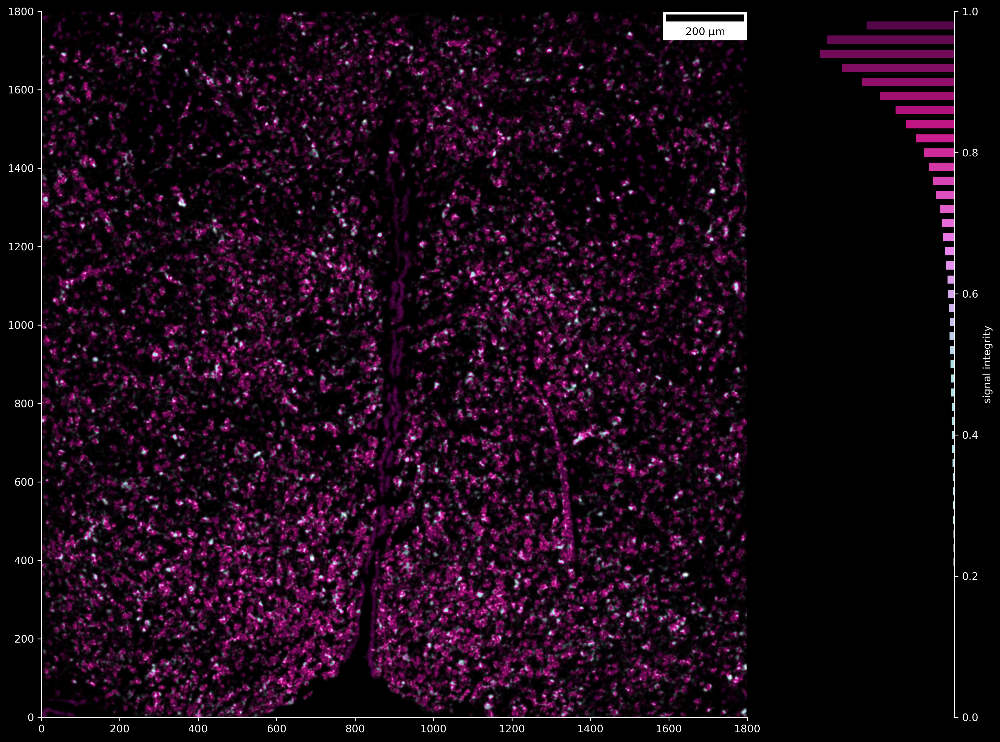

In [22]:
SIM = plot_VSI_map(
    cell_integrity = signal_integrity,
    cell_strength = signal_strength,
    signal_threshold=3.0,
    figure_height=10,
    cmap="BIH",
    side_display="hist",
    plot_boundary=False,
    plot_centroid=False,
)

display(SIM)

#### MOD1 vs MOD2
This section shows the VSI distributions in both subtypes.  

In [23]:
MOD1_int, MOD1_str = extract_cell_vsi(MOD1_boundaries, signal_integrity, signal_strength)
MOD2_int, MOD2_str = extract_cell_vsi(MOD2_boundaries, signal_integrity, signal_strength)

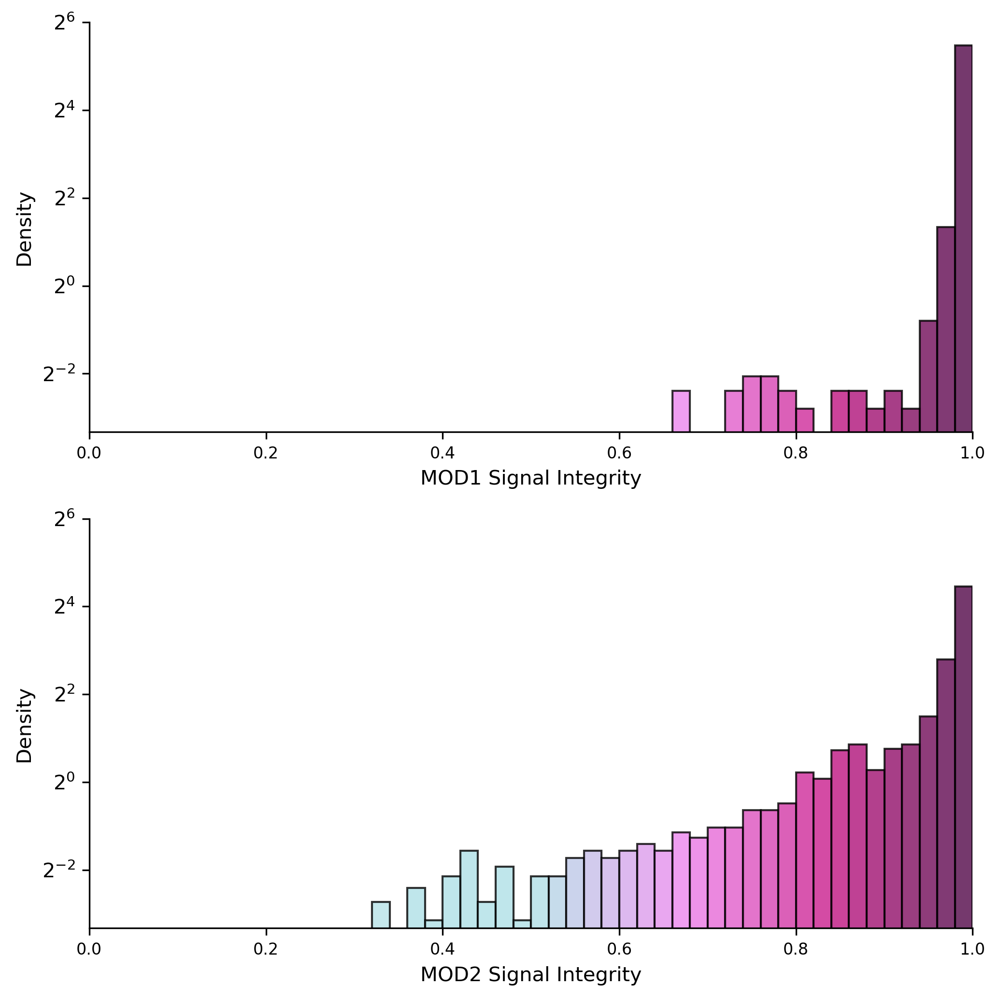

In [24]:
vals1, bins1, vals2, bins2 = plot_vsi_distribution_comparison(
    cell_integrity_1=MOD1_int,
    cell_strength_1=MOD1_str,
    cell_integrity_2=MOD2_int,
    cell_strength_2=MOD2_str,
    signal_threshold=3.0,
    figure_height=7,
    cmap="BIH",
    ylim=(1e-1,64)
)

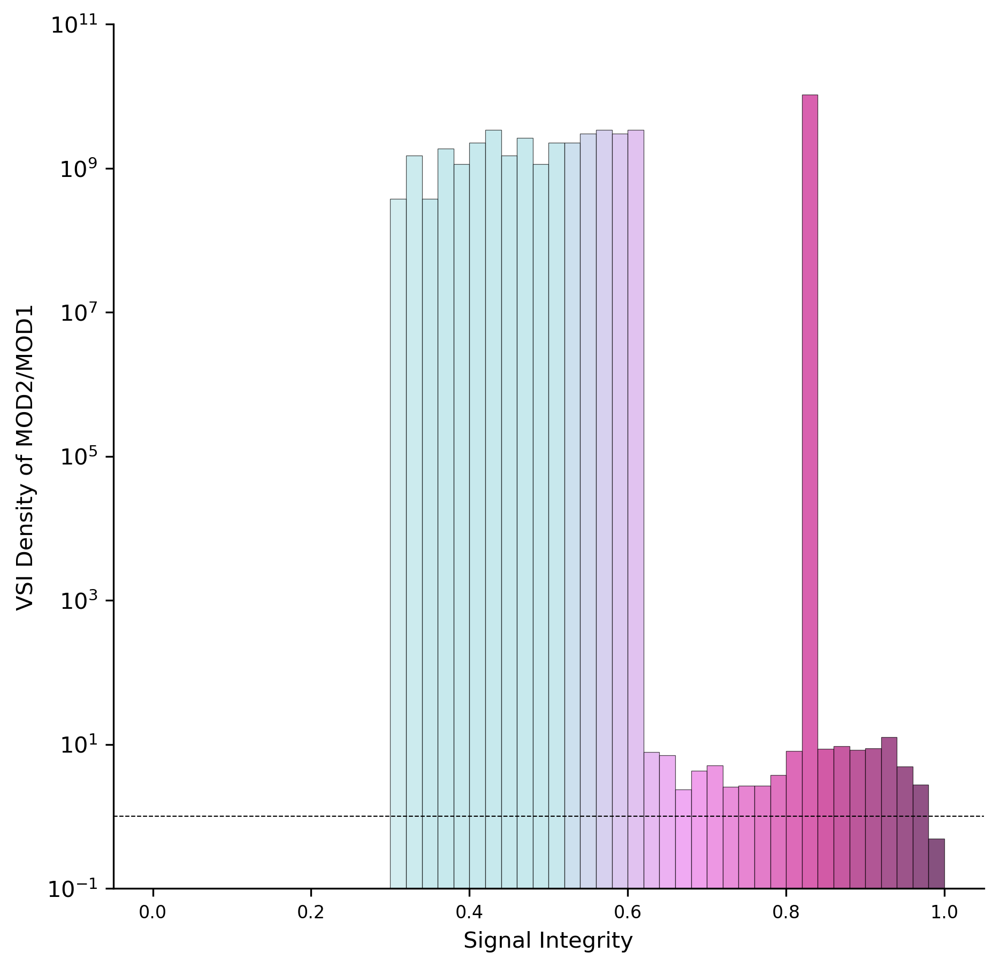

In [25]:
plot_normalized_histogram(vals1, vals2, bins=bins1, epsilon= 1e-10, ylim=(1e-1, 10**11))

d:\miniconda\envs\ovrlpy_0513\Lib\site-packages\scipy\interpolate\_interpolate.py:479: RuntimeWarning: divide by zero encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
d:\miniconda\envs\ovrlpy_0513\Lib\site-packages\scipy\interpolate\_interpolate.py:482: RuntimeWarning: invalid value encountered in multiply
  y_new = slope*(x_new - x_lo)[:, None] + y_lo


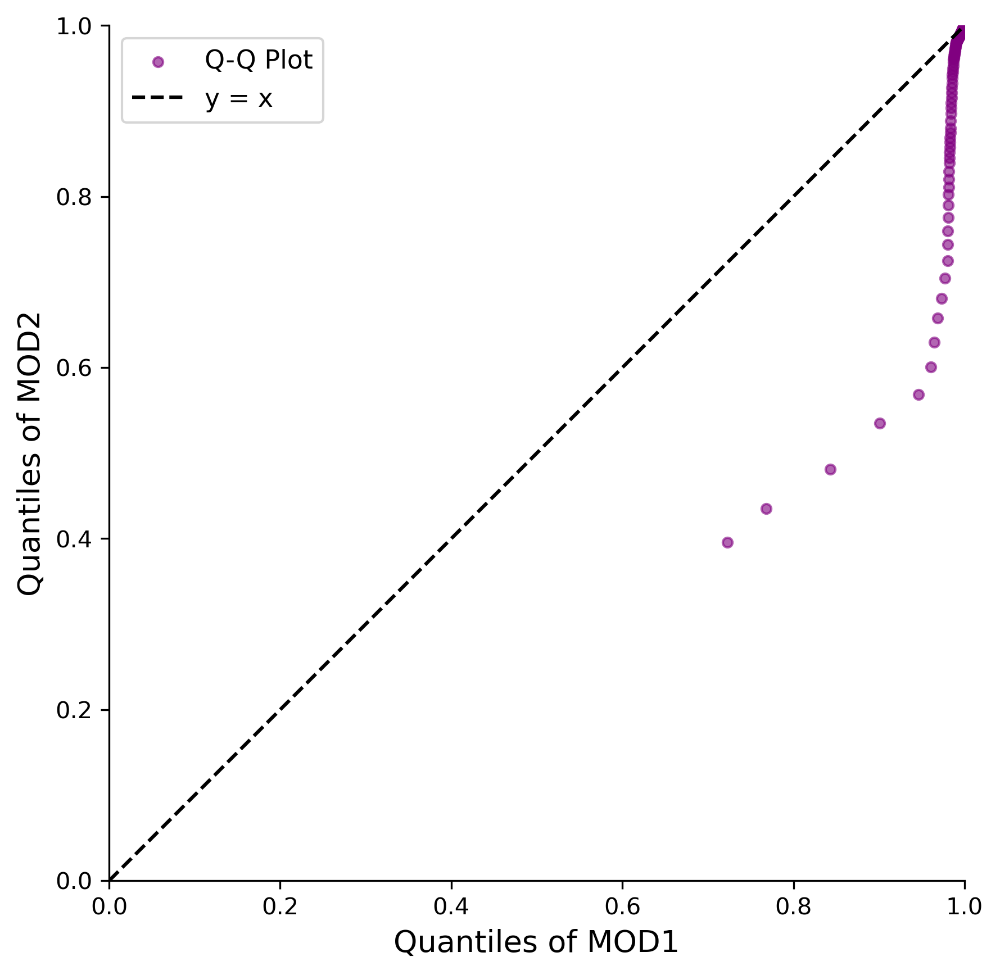

In [26]:
plot_vsi_qqplot(vals1, bins1, vals2, bins2)

### Markers are not reliable to distinguish the two subtypes
`BANKSY` identified MOD subtype-specific markers through differential expression analysis using spatial transcriptomic data  
- for **MOD1**: Mbp, Lpar1, Trh, Ucn3, and Cck  
- for **MOD2**: Mlc1, Dgkk, Cbln2, Syt4, Gad1, Plin3, Gnrh1, Sln, and Gjc3

These markers were validated using scRNA-seq by identifying the 25 most correlated genes and visualizing UMAPs from the top 5 PCs.  
However, further analysis (in sections below) reveals issues.  

#### MOD1/2 specific markers are expressed in broader regions beyond MODs

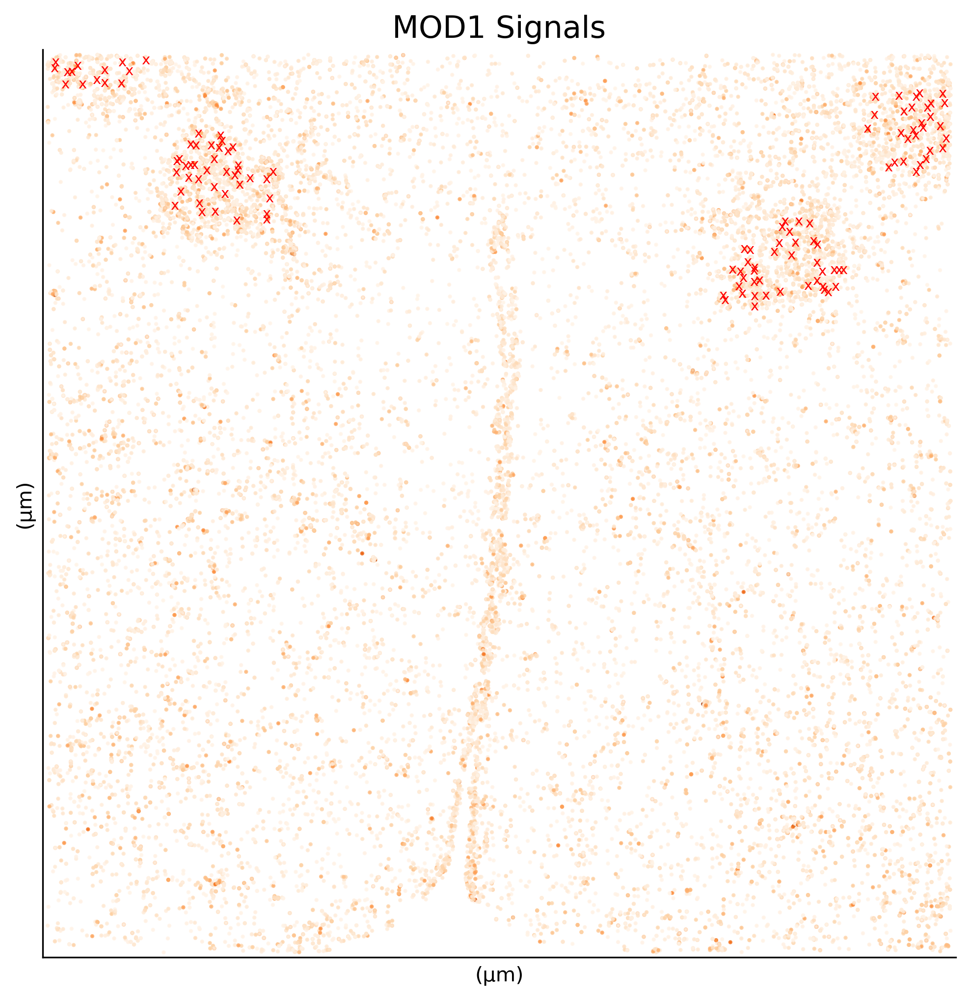

In [27]:
plot_marker_signals(signal_df=MOD1_signals, centroid_df= MOD1_df, title="MOD1 Signals", color="MOD1")

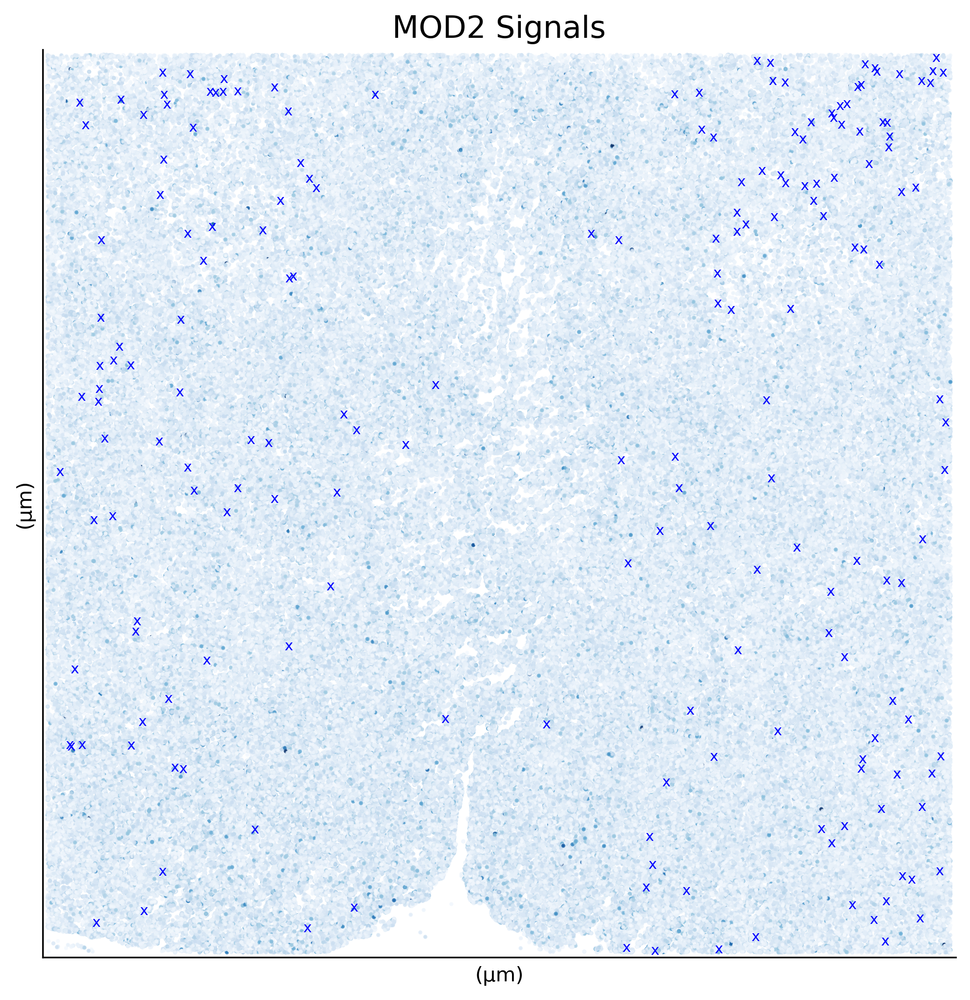

In [28]:
plot_marker_signals(signal_df=MOD2_signals, centroid_df= MOD2_df, title="MOD2 Signals", color="MOD2")

#### Marker expression patterns in scRNA-seq and ST are inconsistent

In [29]:
MOD_banksy = MOD_banksy.replace({7: 'MOD2', 8: 'MOD1'})

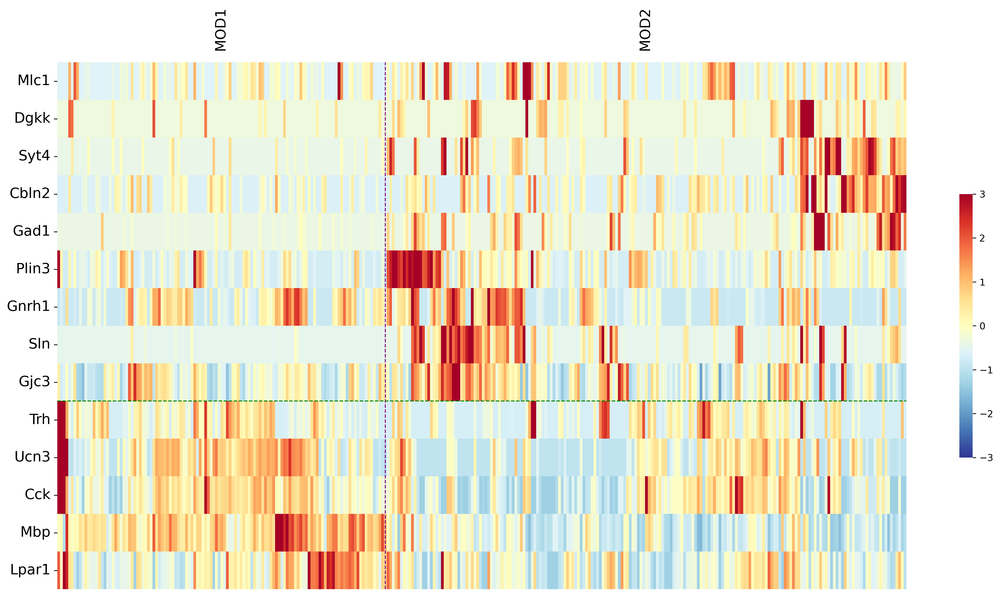

In [30]:
plot_annotate_heatmap(cluster_data=MOD_merfish_DE.T, cluster_labels=MOD_banksy, gene_groups=Gene_Group, cluster_text_y=-0.9)

In [31]:
MOD_sc_data = pd.concat([sc_DE, sc_cell_class], axis=1)
MOD_sc_data = MOD_sc_data[MOD_sc_data['Cell_class'].str.startswith("OD mat")]

MOD_sc_cell_class = MOD_sc_data['Cell_class']
MOD_sc_data = MOD_sc_data.drop('Cell_class', axis=1)

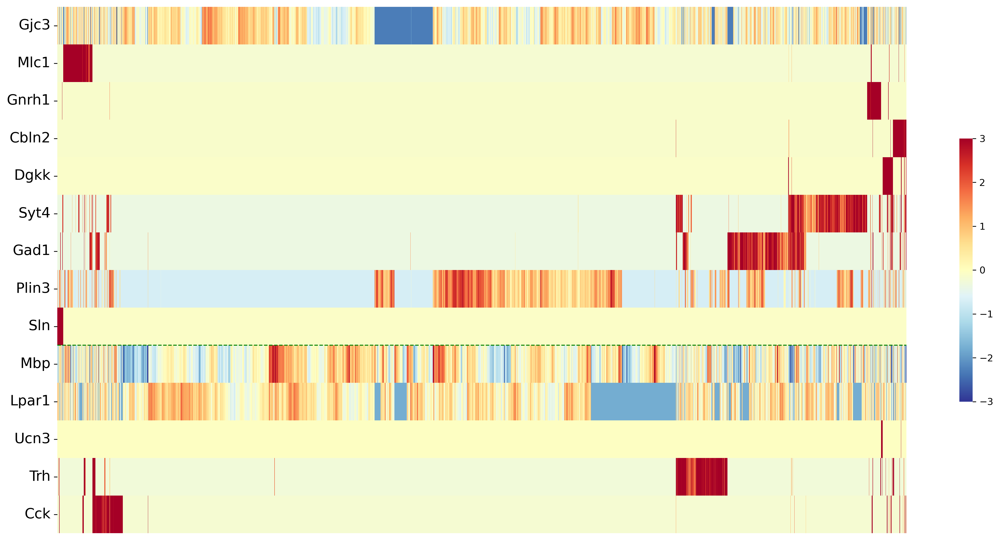

In [32]:
plot_annotate_heatmap(cluster_data = MOD_sc_data, cluster_labels=MOD_sc_cell_class, gene_groups=Gene_Group, show_cluster=False, box_specs=None)

#### Many MOD2 markers are highly expressed in neurons

In [33]:
OD_mask = merfish_data['Cell_class'].str.startswith("OD")
no_OD_merfish_data = merfish_data.drop(merfish_data.index[OD_mask], axis=0, inplace=False)

common_genes_gm = [gene for gene in DE_genes_MOD2 if gene in no_OD_merfish_data.columns]
no_OD_merfish_DE_gm = no_OD_merfish_data[common_genes_gm]

common_genes_wm = [gene for gene in DE_genes_MOD1 if gene in no_OD_merfish_data.columns]
no_OD_merfish_DE_wm = no_OD_merfish_data[common_genes_wm]

no_OD_merfish_DE = pd.concat([no_OD_merfish_DE_gm, no_OD_merfish_DE_wm], axis=1).T

no_OD_cell_class = no_OD_merfish_data['Cell_class']

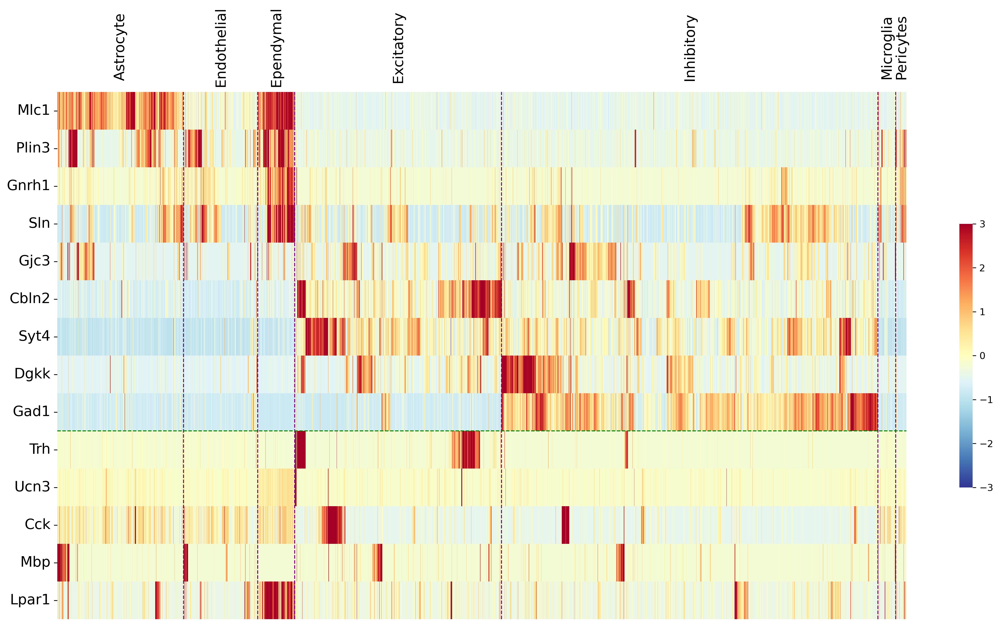

In [34]:
plot_annotate_heatmap(cluster_data=no_OD_merfish_DE.T, cluster_labels=no_OD_cell_class, gene_groups=Gene_Group)

In [35]:
noOD_sc_data = pd.concat([sc_DE, sc_cell_class], axis=1)
noOD_sc_data = noOD_sc_data[~noOD_sc_data['Cell_class'].str.startswith("OD")]

noOD_sc_cell_class = noOD_sc_data['Cell_class']
noOD_sc_data = noOD_sc_data.drop('Cell_class', axis=1)

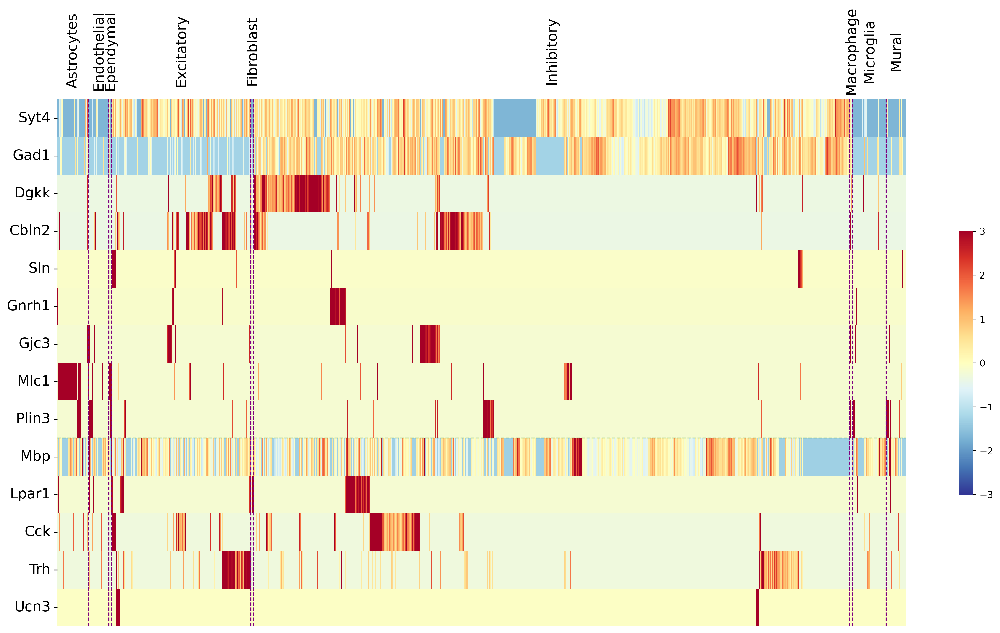

In [36]:
plot_annotate_heatmap(cluster_data = noOD_sc_data, cluster_labels=noOD_sc_cell_class, gene_groups=Gene_Group, cluster_text_y=-1.3)

### VSI under different condition
Examine VSI under different marker exclusion conditions to assess whether MOD marker transcripts influence VSI:  
- using all transcripts  
- excluding MOD1 markers  
- excluding MOD2 markers  
- excluding all MOD markers  

Excluding MOD2 markers led to higher VSI values, with distributions more concentrated near 1, suggesting that the low VSI associated with MOD2 markers may reflect artifacts from cell overlap.

In [37]:
cell_si, cell_ss = extract_cell_vsi(boundary_df=boundaries_df, integrity=signal_integrity, strength=signal_strength, integrity_size=1800)
cell_si_nonMOD1, cell_ss_nonMOD1 = extract_cell_vsi(boundary_df=boundaries_df, integrity=nonMOD1_signal_integrity, strength=nonMOD1_signal_strength, integrity_size=1800)
cell_si_nonMOD2, cell_ss_nonMOD2 = extract_cell_vsi(boundary_df=boundaries_df, integrity=nonMOD2_signal_integrity, strength=nonMOD2_signal_strength, integrity_size=1800)
cell_si_nonMOD, cell_ss_nonMOD = extract_cell_vsi(boundary_df=boundaries_df, integrity=nonMOD_signal_integrity, strength=nonMOD_signal_strength, integrity_size=1800)

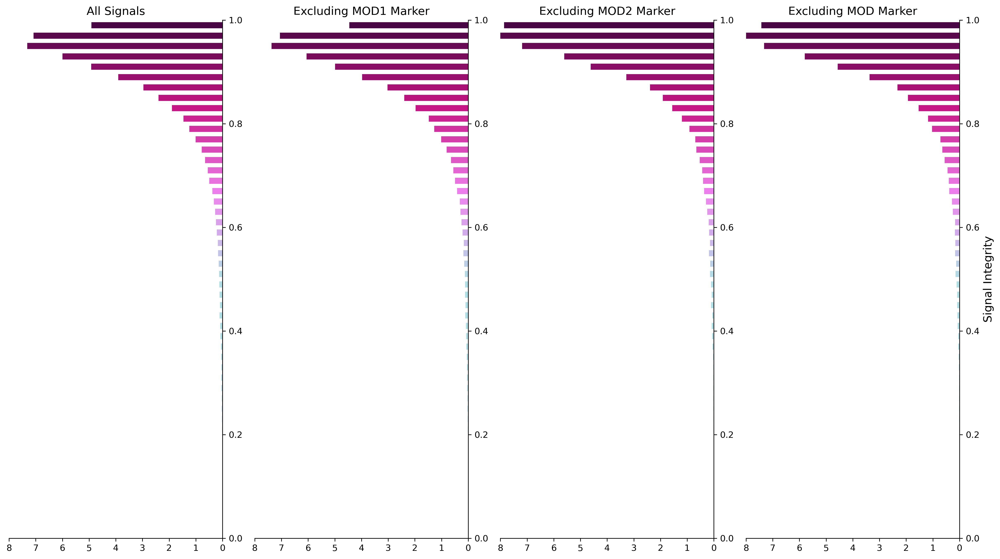

In [38]:
histogram_comparison(cell_si, cell_ss, 
                     cell_si_nonMOD1, cell_ss_nonMOD1, 
                     cell_si_nonMOD2, cell_ss_nonMOD2,
                     cell_si_nonMOD, cell_ss_nonMOD, 
                     signal_threshold=3, xlim=(0,8), log=False)

In [41]:
MOD1_si, MOD1_ss = extract_cell_vsi(boundary_df=MOD1_boundaries, integrity=signal_integrity, strength=signal_strength, integrity_size=1800)
MOD1_si_nonMOD1, MOD1_ss_nonMOD1 = extract_cell_vsi(boundary_df=MOD1_boundaries, integrity=nonMOD1_signal_integrity, strength=nonMOD1_signal_strength, integrity_size=1800)
MOD1_si_nonMOD2, MOD1_ss_nonMOD2 = extract_cell_vsi(boundary_df=MOD1_boundaries, integrity=nonMOD2_signal_integrity, strength=nonMOD2_signal_strength, integrity_size=1800)
MOD1_si_nonMOD, MOD1_ss_nonMOD = extract_cell_vsi(boundary_df=MOD1_boundaries, integrity=nonMOD_signal_integrity, strength=nonMOD_signal_strength, integrity_size=1800)

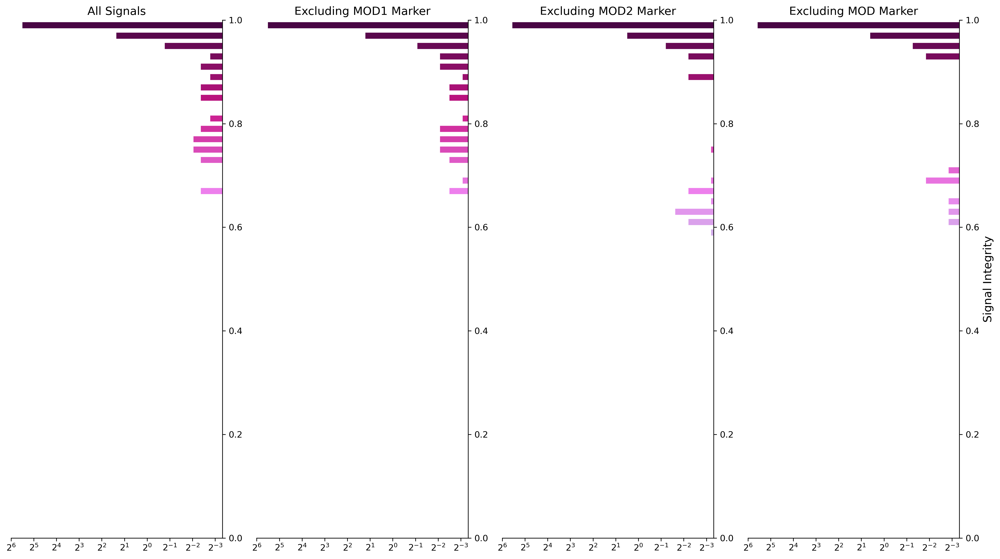

In [42]:
histogram_comparison(MOD1_si, MOD1_ss, 
                     MOD1_si_nonMOD1, MOD1_ss_nonMOD1, 
                     MOD1_si_nonMOD2, MOD1_ss_nonMOD2,
                     MOD1_si_nonMOD, MOD1_ss_nonMOD, 
                     signal_threshold=3, xlim=(1e-1,64), log=True)

In [43]:
MOD2_si, MOD2_ss = extract_cell_vsi(boundary_df=MOD2_boundaries, integrity=signal_integrity, strength=signal_strength, integrity_size=1800)
MOD2_si_nonMOD1, MOD2_ss_nonMOD1 = extract_cell_vsi(boundary_df=MOD2_boundaries, integrity=nonMOD1_signal_integrity, strength=nonMOD1_signal_strength, integrity_size=1800)
MOD2_si_nonMOD2, MOD2_ss_nonMOD2 = extract_cell_vsi(boundary_df=MOD2_boundaries, integrity=nonMOD2_signal_integrity, strength=nonMOD2_signal_strength, integrity_size=1800)
MOD2_si_nonMOD, MOD2_ss_nonMOD = extract_cell_vsi(boundary_df=MOD2_boundaries, integrity=nonMOD_signal_integrity, strength=nonMOD_signal_strength, integrity_size=1800)

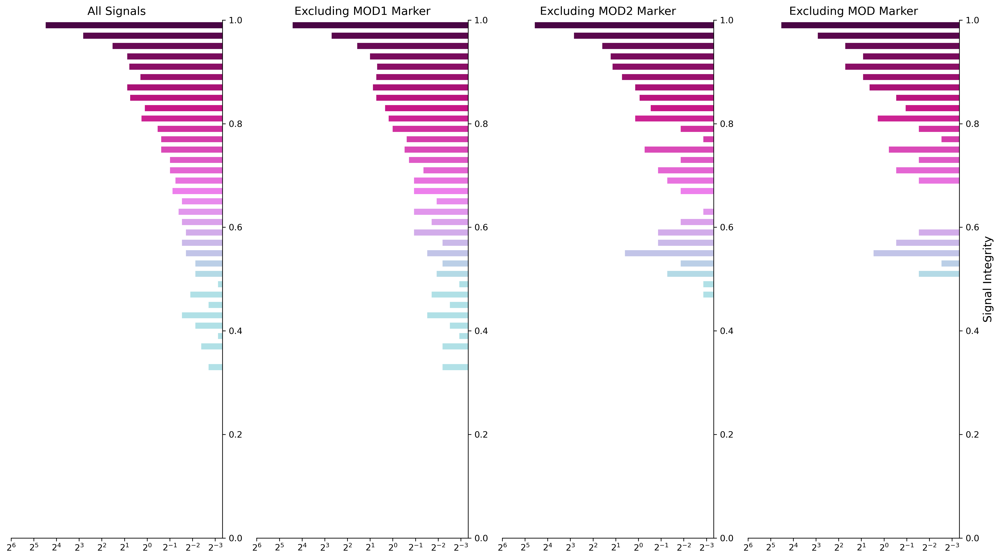

In [44]:
histogram_comparison(MOD2_si, MOD2_ss, 
                     MOD2_si_nonMOD1, MOD2_ss_nonMOD1, 
                     MOD2_si_nonMOD2, MOD2_ss_nonMOD2,
                     MOD2_si_nonMOD, MOD2_ss_nonMOD, 
                     signal_threshold=3, xlim=(1e-1,64), log=True)

In [ ]:
MOD_si, MOD_ss = extract_cell_vsi(boundary_df=MOD_boundaries, integrity=signal_integrity, strength=signal_strength, integrity_size=1800)
MOD_si_nonMOD1, MOD_ss_nonMOD1 = extract_cell_vsi(boundary_df=MOD_boundaries, integrity=nonMOD1_signal_integrity, strength=nonMOD1_signal_strength, integrity_size=1800)
MOD_si_nonMOD2, MOD_ss_nonMOD2 = extract_cell_vsi(boundary_df=MOD_boundaries, integrity=nonMOD2_signal_integrity, strength=nonMOD2_signal_strength, integrity_size=1800)
MOD_si_nonMOD, MOD_ss_nonMOD = extract_cell_vsi(boundary_df=MOD_boundaries, integrity=nonMOD_signal_integrity, strength=nonMOD_signal_strength, integrity_size=1800)

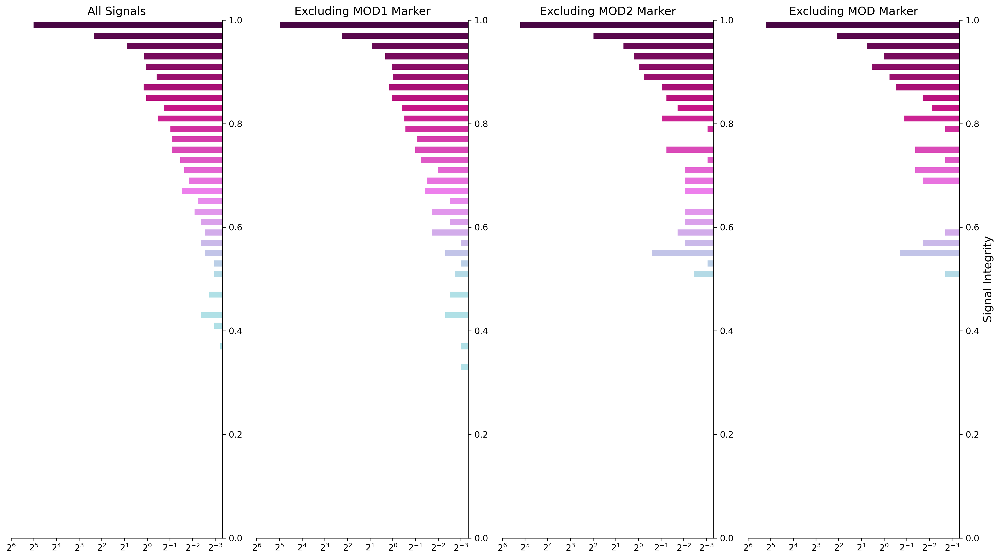

In [ ]:
histogram_comparison(MOD_si, MOD_ss, 
                     MOD_si_nonMOD1, MOD_ss_nonMOD1, 
                     MOD_si_nonMOD2, MOD_ss_nonMOD2,
                     MOD_si_nonMOD, MOD_ss_nonMOD, 
                     signal_threshold=3, xlim=(1e-1,64), log=True)